# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import os
from collections import Counter
from wordcloud import WordCloud


# Load data

In [2]:
sets = ['google_data_first.csv', 'google_data_last.csv', 'app_sdk.csv']
data_sets = []
for dataset in sets:
  path = os.path.join('data', dataset)
  df = pd.read_csv(path, encoding='ISO-8859-1')
  data_sets.append(df)
google_first, google_last, app_sdk = data_sets

for i in range(len(data_sets)):
  data_sets[i].drop(['Unnamed: 0'], axis=1, inplace=True)

FileNotFoundError: ignored

# Distributions of ratings and review counts

<Axes: xlabel='rating_app', ylabel='Count'>

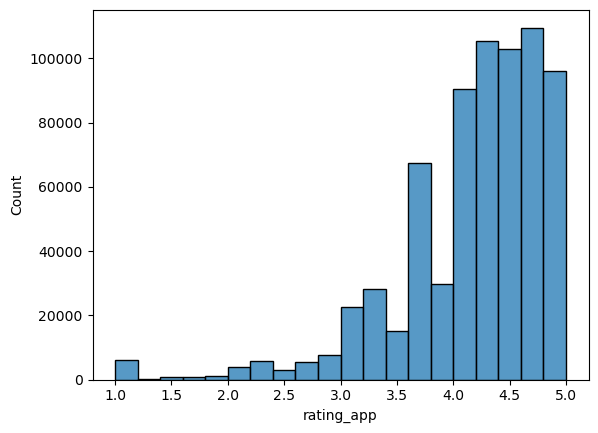

In [ ]:
# sns.kdeplot(x='rating_app', data=google_first)
sns.histplot(x='rating_app', data=google_first, bins=20)

In [ ]:
# cast nb_rating to int, commas are deleted, there are no 0 values so we assume that NAN means 0 rating
google_first['nb_rating'] = google_first['nb_rating'].str.replace(',', '')
# fill with 0.1 if you want log scale
google_first['nb_rating'].fillna(0, inplace=True)
google_first['nb_rating'] = google_first['nb_rating'].astype(float)

Max number of rating an app has in the data:

In [ ]:
google_first['nb_rating'].max()

78719341.0

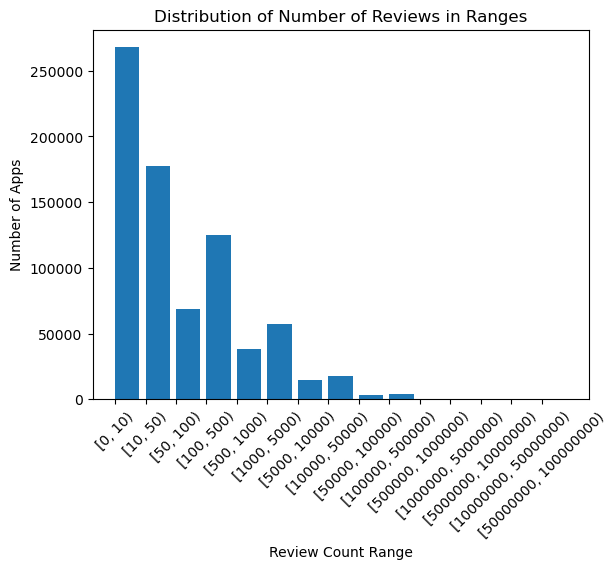

In [ ]:
review_counts = google_first['nb_rating']

# Define the review count ranges
ranges = [0, 10, 50, 100, 500, 1000, 5000, 10000, 50000, 100000, 500000, 1000000, 5000000, 10000000, 50000000, 100000000]

# Use the pandas 'cut' function to create bins for review count ranges
bins = pd.cut(review_counts, ranges, right=False)

# Group apps into review count ranges and count the number of apps in each range
counts = bins.value_counts().sort_index()

# Convert IntervalIndex to strings for plotting
labels = [str(interval) for interval in counts.index]

# Create a bar plot
plt.bar(labels, counts.values, width=0.8, align='edge')
plt.xlabel('Review Count Range')
plt.ylabel('Number of Apps')
plt.title('Distribution of Number of Reviews in Ranges')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()


In [ ]:
rating_scores = google_first['rating_app']

# Group the data by review count ranges and calculate the mean rating score for each group
result = google_first.groupby(bins)['rating_app'].mean()

print(result)

#so each range has a similar average rating, which is nice

nb_rating
[0, 10)                  4.151091
[10, 50)                 4.175059
[50, 100)                4.162911
[100, 500)               4.140853
[500, 1000)              4.137800
[1000, 5000)             4.149435
[5000, 10000)            4.169982
[10000, 50000)           4.207203
[50000, 100000)          4.262406
[100000, 500000)         4.330385
[500000, 1000000)        4.394077
[1000000, 5000000)       4.416854
[5000000, 10000000)      4.456667
[10000000, 50000000)     4.424138
[50000000, 100000000)    4.250000
Name: rating_app, dtype: float64


# Descriptives for finding boundaries for how many reviews an app should have

I was wondering whether the effect of having only 1 review would affect the average of the whole group (e.g. if you only havew 1 review, maybe it's always a fake review so that the average of the group is automatically higher) -> doesn't seem the case

In [ ]:
# Define the range of review counts (1 to 100)
review_count_range = range(1, 101)

# Create an empty list to store the results
average_ratings = []

# Iterate through each review count value
for review_count in review_count_range:
    # Filter the DataFrame to include only apps with the current review count
    apps_with_review_count = google_first[review_counts == review_count]

    # Calculate the average rating for these apps
    average_rating = apps_with_review_count['rating_app'].mean()

    # Append the result to the list
    average_ratings.append(average_rating)

# Print the results
for i, avg_rating in enumerate(average_ratings, start=1):
    print(f"Average rating for apps with {i} review(s): {avg_rating}")


Average rating for apps with 1 review(s): 4.175189369119074
Average rating for apps with 2 review(s): 4.111477184841454
Average rating for apps with 3 review(s): 4.1345016717382315
Average rating for apps with 4 review(s): 4.154172489968892
Average rating for apps with 5 review(s): 4.160974083537571
Average rating for apps with 6 review(s): 4.158469357249626
Average rating for apps with 7 review(s): 4.165464973371568
Average rating for apps with 8 review(s): 4.158122006751983
Average rating for apps with 9 review(s): 4.161609773002946
Average rating for apps with 10 review(s): 4.158575124745888
Average rating for apps with 11 review(s): 4.154329423763386
Average rating for apps with 12 review(s): 4.160297356828194
Average rating for apps with 13 review(s): 4.17354668584442
Average rating for apps with 14 review(s): 4.167405270748656
Average rating for apps with 15 review(s): 4.158874931731294
Average rating for apps with 16 review(s): 4.178807366267174
Average rating for apps with 17 r

I would argue that if we have apps which have the same number of downloads as number of reviews, they are fake. very unlikely. we don't have these, maybe we can analyze this more and for example say that if there 80% of the downloads has placed a review, it is very unlikely and we have to exclude them. maybe some data to back this threshold

In [ ]:
# Create a Boolean mask where num_downloads is equal to nb_rating
same_downloads_and_reviews = num_downloads == review_counts

# Count the number of apps with the same number of downloads and reviews
num_apps_same_downloads_reviews = same_downloads_and_reviews.sum()

# Print the result
print("Number of apps with the same number of downloads and reviews:", num_apps_same_downloads_reviews)

# Nice


Number of apps with the same number of downloads and reviews: 0


In [ ]:
review_count_range = range(1, 101)

# Create an empty list to store the results
percentage_five_star_list = []

for review_count in review_count_range:
    # Filter the DataFrame to include only apps with the current review count
    apps_with_review_count = google_first[review_counts == review_count]

    # Filter apps with a 5-star rating within the filtered subset
    five_star_apps_with_review_count = apps_with_review_count[rating_scores == 5]

    # Calculate the percentage
    if len(apps_with_review_count) > 0:
        percentage_five_star = (len(five_star_apps_with_review_count) / len(apps_with_review_count)) * 100
    else:
        percentage_five_star = 0.0

    # Append the result to the list
    percentage_five_star_list.append((review_count, percentage_five_star))

# Print the results
for review_count, percentage_five_star in percentage_five_star_list:
    print(f"{percentage_five_star:.2f}% of apps with {review_count} review(s) have a 5-star rating.")

/var/folders/mw/vyd37lgd18z9drzdwc0t5jch0000gn/T/ipykernel_15932/438983864.py:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  five_star_apps_with_review_count = apps_with_review_count[rating_scores == 5]


67.65% of apps with 1 review(s) have a 5-star rating.
47.03% of apps with 2 review(s) have a 5-star rating.
35.77% of apps with 3 review(s) have a 5-star rating.
28.64% of apps with 4 review(s) have a 5-star rating.
22.99% of apps with 5 review(s) have a 5-star rating.
18.67% of apps with 6 review(s) have a 5-star rating.
15.53% of apps with 7 review(s) have a 5-star rating.
13.28% of apps with 8 review(s) have a 5-star rating.
11.58% of apps with 9 review(s) have a 5-star rating.
10.04% of apps with 10 review(s) have a 5-star rating.
8.71% of apps with 11 review(s) have a 5-star rating.
7.75% of apps with 12 review(s) have a 5-star rating.
7.06% of apps with 13 review(s) have a 5-star rating.
5.49% of apps with 14 review(s) have a 5-star rating.
5.65% of apps with 15 review(s) have a 5-star rating.
5.51% of apps with 16 review(s) have a 5-star rating.
4.80% of apps with 17 review(s) have a 5-star rating.
4.77% of apps with 18 review(s) have a 5-star rating.
4.29% of apps with 19 revie

# Distributions of rating scores for review counts

In [ ]:
review_counts_to_plot = [1, 2, 5, 100, 500, 1000, 5000]

for count in review_counts_to_plot:
    apps_with_review_count = google_first[review_counts == count]

    # Get the rating scores for these apps
    ratings_for_apps_with_review_count = apps_with_review_count['rating_app']

    # Create a histogram
    plt.hist(ratings_for_apps_with_review_count, bins=20, edgecolor='k')
    plt.xlabel('Rating Scores')
    plt.ylabel('Number of Apps')
    plt.title(f'Distribution of Rating Scores for Apps with {count} Reviews')
    plt.show()

# Distributions of rating scores for [at least] review counts

In [ ]:
review_count_thresholds = [1, 50, 100, 112, 500, 1000, 5000]

for threshold in review_count_thresholds:
    # Filter the DataFrame to include only apps with at least 'threshold' reviews
    apps_with_at_least_threshold_reviews = google_first[review_counts >= threshold]

    # Calculate the average review score for these apps
    average_rating_for_apps_with_reviews = apps_with_at_least_threshold_reviews['rating_app'].mean()

    # Create a histogram for the distribution of review scores
    plt.hist(apps_with_at_least_threshold_reviews['rating_app'], bins=20, edgecolor='k')
    plt.xlabel('Rating Scores')
    plt.ylabel('Number of Apps')
    plt.title(f'Distribution of Rating Scores for Apps with at Least {threshold} Review(s)')
    plt.show()

    # Print the average review score
    print(f"Average rating for apps with at least {threshold} review(s): {average_rating_for_apps_with_reviews:.2f}")

# Permissions

In [ ]:
google_first['permissions']

0                                                       NaN
1                                                       NaN
2         view network connections,   full network acces...
3                                                       NaN
4                                                       NaN
                                ...                        
775897    approximate location (network-based),   precis...
775898    approximate location (network-based),   precis...
775899    approximate location (network-based),   precis...
775900    retrieve running apps,   read sensitive log da...
775901    read the contents of your USB storage,   modif...
Name: permissions, Length: 775902, dtype: object

# todo: Fix regex to take out the spaces as you can see here above for row 2

In [ ]:
google_first['permissions'].fillna('', inplace=True)  # Replace NaN with an empty string
google_first['permissions'] = google_first['permissions'].str.replace(r'[^\w\s,]', '').str.strip() # Only keep wanted characters
google_first['permissions'] = google_first['permissions'].str.split(', ') # Split each string into a list of items

In [ ]:
google_first['permissions']

0                                                        []
1                                                        []
2         [view network connections,   full network acce...
3                                                        []
4                                                        []
                                ...                        
775897    [approximate location networkbased,   precise ...
775898    [approximate location networkbased,   precise ...
775899    [approximate location networkbased,   precise ...
775900    [retrieve running apps,   read sensitive log d...
775901    [read the contents of your USB storage,   modi...
Name: permissions, Length: 775902, dtype: object

In [ ]:
# Get unique values
unique_permissions = set(all_permissions)

# Convert the set back to a list
unique_permissions_list = list(unique_permissions)


In [ ]:
unique_permissions_list

['',
 '  bind to a text service',
 '  force background apps to close',
 '  access all TV channelprogram information',
 '   6 more items',
 '  mountunmount internal storage',
 '  Provide a trust agent',
 '  Google Finance',
 '  reorder running apps',
 '  act as the AccountManagerService',
 '  freeze screen',
 'record audio',
 '  read calendar events plus confidential information',
 'transmit infrared',
 'read sensitive log data',
 '  draw over other apps',
 'press keys and control buttons',
 '  filter events',
 '  capture audio output',
 'change system display settings',
 'add or modify calendar events and send email to guests without owners knowledge',
 'send sticky broadcast',
 '  receive text messages SMS',
 '  make app always run',
 '  create internal storage',
 'access checkin properties',
 '  read call log',
 '  access external storage of all users',
 '  limit number of running processes',
 '  stop running apps',
 '  manage preferences and permissions for USB devices',
 '  get inf

In [ ]:
len(unique_permissions_list)

404

So in the google play store data we have 404 unique permissions

# Most common permissions:

In [ ]:
# Flatten the list of permissions
all_permissions = [permission for permissions_list in google_first['permissions'] for permission in permissions_list]

# Count the occurrences of each permission
permission_counts = Counter(all_permissions)

# Find the most common permissions
most_common_permissions = permission_counts.most_common()

# Print the top N most common permissions
N = 30  # Change this value to see the top N most common permissions
for permission, count in most_common_permissions[:N]:
    print(f'{permission}: {count}')


  full network access: 623317
  view network connections: 541596
  modify or delete the contents of your USB storage: 465279
  prevent device from sleeping: 404177
  receive data from Internet: 315394
  read the contents of your USB storage: 250730
  view WiFi connections: 241857
read the contents of your USB storage: 225059
  control vibration: 220414
  read phone status and identity: 173310
  precise location GPS and networkbased: 157966
  run at startup: 156232
view network connections: 142813
  take pictures and videos: 116996
full network access: 102286
approximate location networkbased: 96690
find accounts on the device: 87186
  approximate location networkbased: 76514
  read Google service configuration: 59673
  record audio: 53752
  draw over other apps: 50928
  pair with Bluetooth devices: 48469
retrieve running apps: 47870
  set wallpaper: 46823
  directly call phone numbers: 42919
  modify system settings: 38816
view WiFi connections: 37100
  connect and disconnect from WiFi

# Most common permissions shared across all categories

In [ ]:
google_first['categ_app'].unique()

array(['Photography', 'Racing', 'Entertainment', 'Personalization',
       'Tools', 'Books & Reference', 'Puzzle', 'Social', 'Sports',
       'News & Magazines', 'Maps & Navigation', 'Finance', 'Productivity',
       'Education', 'Medical', 'Communication', 'Business',
       'Video Players & Editors', 'Travel & Local', 'Music & Audio',
       'Arcade', 'Lifestyle', 'Role Playing', 'Card', 'Shopping',
       'Health & Fitness', 'Auto & Vehicles', 'Weather', 'Casual',
       'Action', 'Board', 'Comics', 'Libraries & Demo', 'Food & Drink',
       'House & Home', 'Strategy', 'Adventure', 'Casino', 'Trivia',
       'Music & Video', 'Art & Design', 'Creativity', 'Simulation',
       'Word', 'Events', 'Parenting', 'Action & Adventure', 'Music',
       'Educational', 'Brain Games', 'Dating', 'Pretend Play', 'Beauty',
       nan], dtype=object)

In [ ]:
# Create an empty dictionary to store common permissions for each app category
common_permissions_by_category = {}

# Group the data by app category
grouped = google_first.groupby('categ_app')

# Loop through all app categories and find common permissions
for category, group in grouped:
    # Count the occurrences of each permission
    permission_counts = Counter(all_permissions)

    # Find the most common permissions for the category
    most_common_permissions = permission_counts.most_common(30) # Not sure how to define this threshold

    # Store the most common permissions for the category
    common_permissions_by_category[category] = [permission for permission, count in most_common_permissions]

# Find the permissions that are common across all app categories
common_permissions_across_categories = set(common_permissions_by_category[next(iter(common_permissions_by_category))])
for category, permissions in common_permissions_by_category.items():
    common_permissions_across_categories.intersection_update(permissions)

# Print the common permissions across categories
print("Most common permissions which ALL apps require in ALL categories:")
for permission in common_permissions_across_categories:
    print(permission)

Most common permissions which ALL apps require in ALL categories:
  prevent device from sleeping
  view network connections
  run at startup
  read the contents of your USB storage
  receive data from Internet
find accounts on the device
  full network access
approximate location networkbased
  precise location GPS and networkbased
  modify or delete the contents of your USB storage
  read phone status and identity
  control vibration
  view WiFi connections


# Word cloud per category

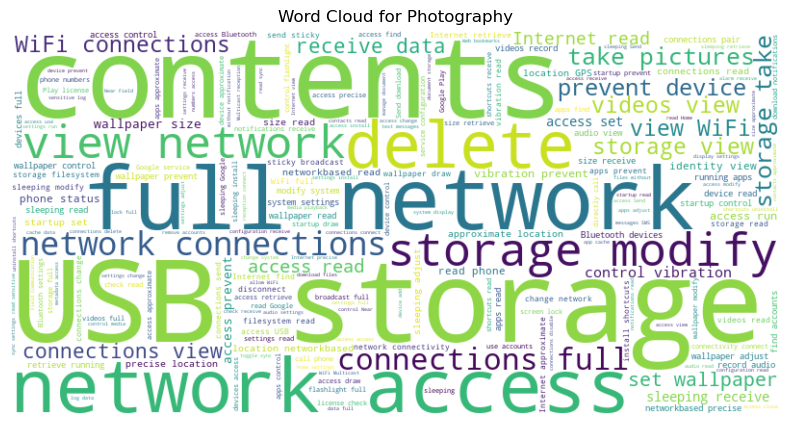

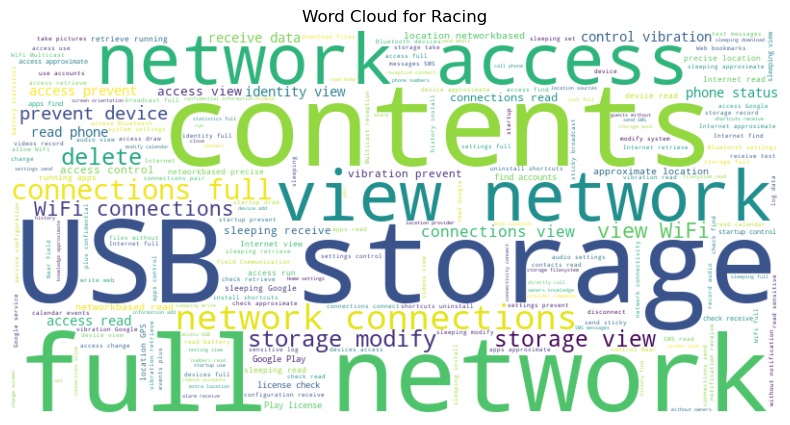

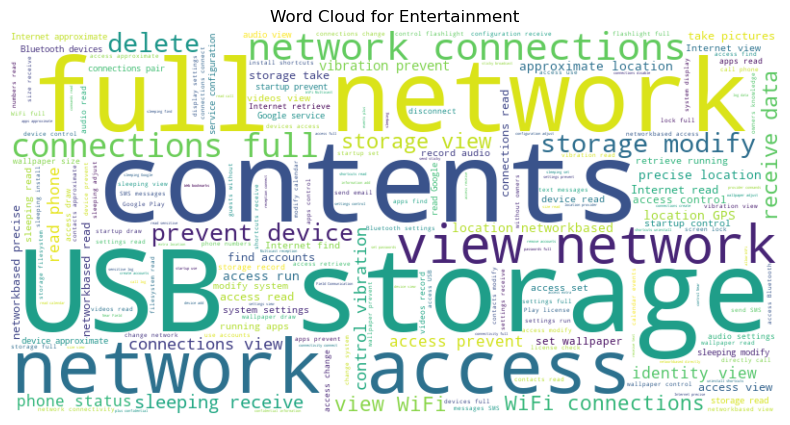

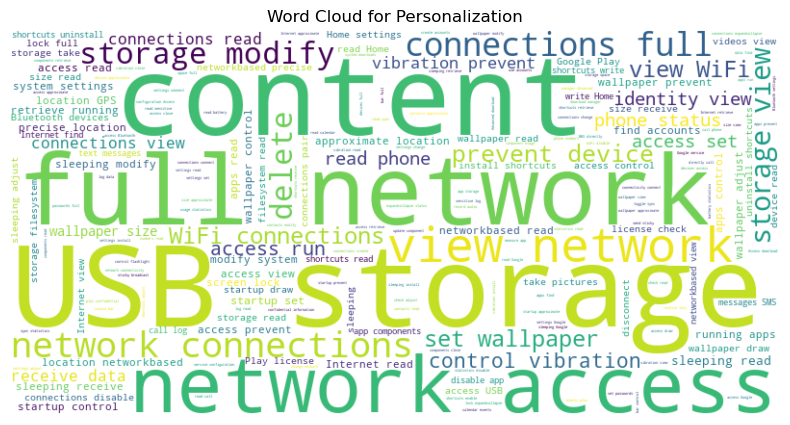

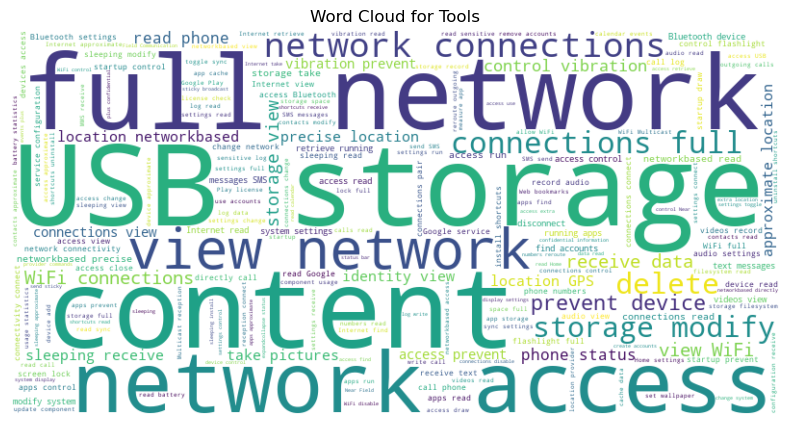

...

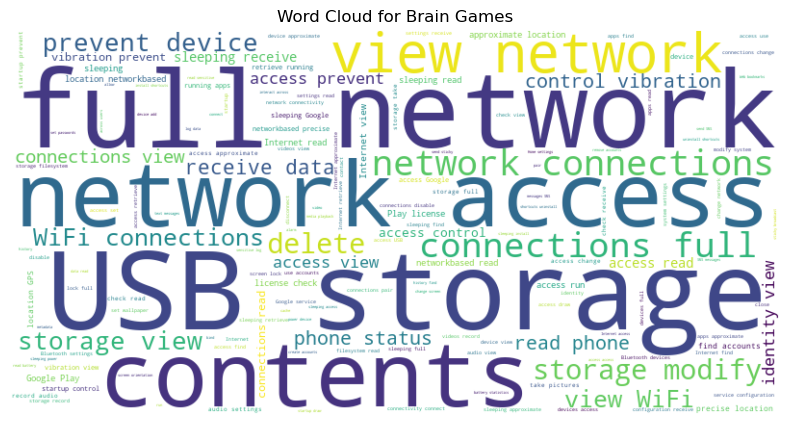

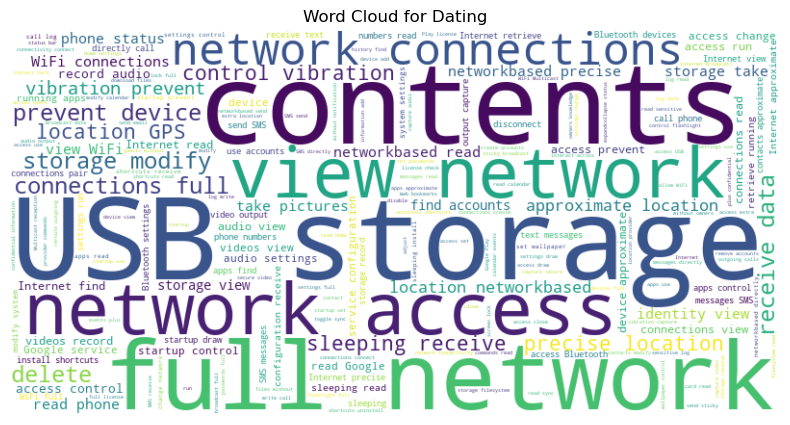

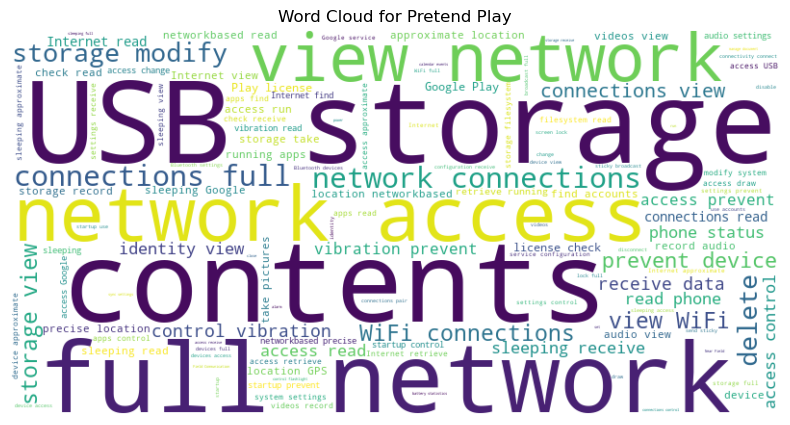

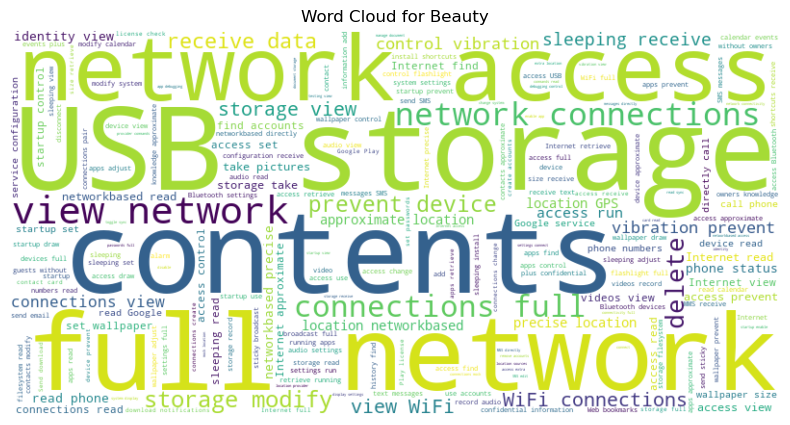

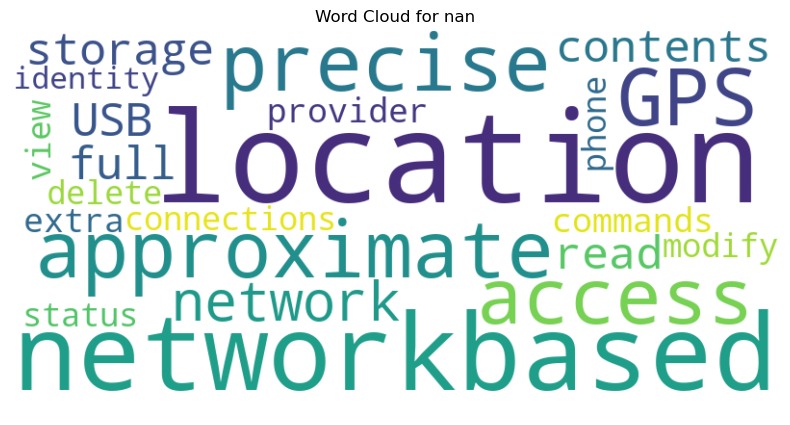

In [ ]:
categories = google_first['categ_app']
permissions_lists = google_first['permissions']

# Initialize an empty dictionary to store permissions by category
permissions_by_category = {}

# Combine permissions for each category
for category, permissions in zip(categories, permissions_lists):
    if category not in permissions_by_category:
        permissions_by_category[category] = []
    permissions_by_category[category].extend(permissions)

# Create word clouds for each category
for category, permissions in permissions_by_category.items():
    text = ' '.join(permissions)
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Display the word cloud with the category name
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for {category}')
    plt.show()
